In [49]:
import matplotlib.pyplot as plt
import pandas as pd
import os
import numpy as np

from influxdb_client import InfluxDBClient, Point, WritePrecision
from influxdb_client.client.write_api import SYNCHRONOUS

from solar_sim import SolarBatterySim, Battery, NetConsumptionProfile

TOKEN = os.environ.get("INFLUXDB_TOKEN")
ORG = "admin"
URL = "http://192.168.1.226:8086"

# This query is not very performant, at least not yet, so we need a pretty long
# timeout
client = InfluxDBClient(URL, TOKEN, ORG, timeout=10_000_000)

In [2]:
query_api = client.query_api()

query = """
import "strings"
from(bucket: "home_assistant")
|> range(start: -1d)
|> filter(fn: (r) => strings.containsStr(v: r.friendly_name, substr: "PVS")
and r._measurement == "kWh"
)
|> pivot(rowKey:["_time"], columnKey: ["_field"], valueColumn: "_value")
"""
df = query_api.query_data_frame(query, org="admin")

# Adjust for tz difference
df["CST_time"] = df["_time"] - pd.to_timedelta("6h")

>>> Request: 'POST http://192.168.1.226:8086/api/v2/query?org=admin'
>>> Accept: application/json
>>> Content-Type: application/json
>>> Authorization: ***
>>> User-Agent: influxdb-client-python/1.44.0
>>> Body: {'extern': {'imports': [], 'body': []}, 'query': '\nimport "strings"\nfrom(bucket: "home_assistant")\n|> range(start: -1d)\n|> filter(fn: (r) => strings.containsStr(v: r.friendly_name, substr: "PVS")\nand r._measurement == "kWh"\n)\n|> pivot(rowKey:["_time"], columnKey: ["_field"], valueColumn: "_value")\n', 'dialect': {'header': True, 'delimiter': ',', 'annotations': ['datatype', 'group', 'default'], 'commentPrefix': '#', 'dateTimeFormat': 'RFC3339'}}
<<< Response: 200
<<< Content-Type: text/csv; charset=utf-8
<<< Vary: Accept-Encoding
<<< X-Influxdb-Build: OSS
<<< X-Influxdb-Version: v2.7.4
<<< Date: Sat, 04 Jan 2025 23:38:16 GMT
<<< Transfer-Encoding: chunked
<<< Body: b'#datatype,string,long,dateTime:RFC3339,dateTime:RFC3339,dateTime:RFC3339,string,string,string,string,stri

In [3]:
df["friendly_name"].unique()

array(['Power Meter PVS6M22422942c KWh To Grid',
       'Power Meter PVS6M22422942c KWh To Home',
       'Power Meter PVS6M22422942c Lifetime Power',
       'Power Meter PVS6M22422942p Lifetime Power'], dtype=object)

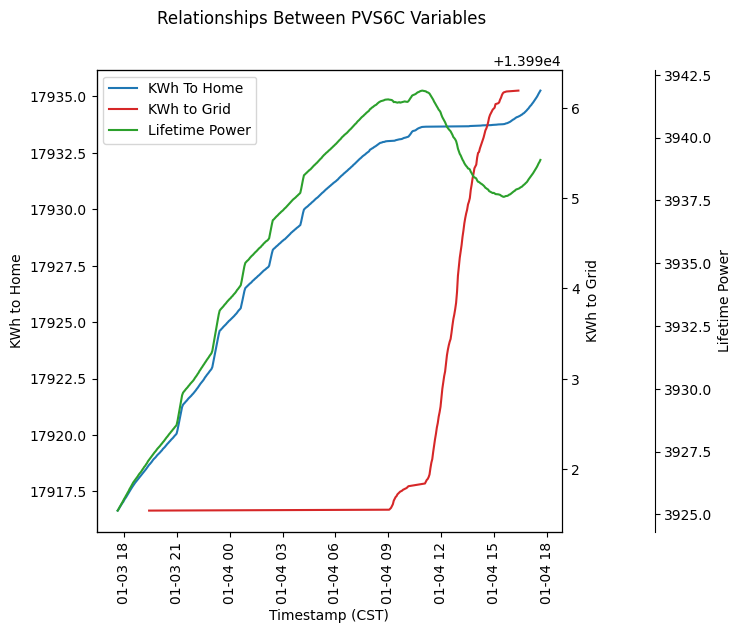

In [4]:
# AHHHH what do these mean and how are they related
fig, ax = plt.subplots(figsize=[6, 6])
fig.suptitle("Relationships Between PVS6C Variables")

twin1 = ax.twinx()
twin2 = ax.twinx()

# Offset the right spine of twin2.  The ticks and label have already been
# placed on the right by twinx above.
twin2.spines.right.set_position(("axes", 1.2))

(p1,) = ax.plot(
    df[df["friendly_name"] == "Power Meter PVS6M22422942c KWh To Home"]["CST_time"],
    df[df["friendly_name"] == "Power Meter PVS6M22422942c KWh To Home"]["value"],
    label="KWh To Home",
    color="tab:blue",
)
(p2,) = twin1.plot(
    df[df["friendly_name"] == "Power Meter PVS6M22422942c KWh To Grid"]["CST_time"],
    df[df["friendly_name"] == "Power Meter PVS6M22422942c KWh To Grid"]["value"],
    label="KWh to Grid",
    color="tab:red",
)
(p3,) = twin2.plot(
    df[df["friendly_name"] == "Power Meter PVS6M22422942c Lifetime Power"]["CST_time"],
    df[df["friendly_name"] == "Power Meter PVS6M22422942c Lifetime Power"]["value"],
    label="Lifetime Power",
    color="tab:green",
)

ax.tick_params(axis="x", rotation=90)
ax.set_ylabel("KWh to Home")
ax.set_xlabel("Timestamp (CST)")
twin1.set_ylabel("KWh to Grid")
twin2.set_ylabel("Lifetime Power")

ax.legend(handles=[p1, p2, p3])
plt.show()

In [5]:
# We want to get:
# Total Daily Production
# Total Daily Consumption

# Total Consumption = Grid Consumption + Solar Consumption
# Solar Consumption = Solar Production - Solar Export
# Grid Consumption == KWh to Home
# Solar Production == Power Meter PVS6M22422942p Lifetime Power
# Solar Export == KWh to Grid

In [6]:
# Try to make something more performant here by querying for direct matches instead
# of relying on substring searches
query = """
from(bucket: "home_assistant_deprecated")
  // The timestamps are reported in UTC, and 600AM UTC should align with 1200AM CST.
  |> range(start: 2024-07-01T06:00:00Z, stop: 2024-10-01T06:00:00Z)
  |> filter(fn: (r) => r.friendly_name == "Power Meter PVS6M22422942c KWh To Grid" 
      or r.friendly_name == "Power Meter PVS6M22422942c KWh To Home" 
      or r.friendly_name == "Power Meter PVS6M22422942c Lifetime Power" 
      or r.friendly_name == "Power Meter PVS6M22422942p Lifetime Power"
  )
  |> pivot(rowKey: ["_time", "friendly_name"], columnKey: ["_field"], valueColumn: "_value")
"""

# Test
raw = query_api.query_data_frame(query, org="admin")
# Adjust for tz difference
raw["CST_time"] = raw["_time"] - pd.to_timedelta("6h")

>>> Request: 'POST http://192.168.1.226:8086/api/v2/query?org=admin'
>>> Accept: application/json
>>> Content-Type: application/json
>>> Authorization: ***
>>> User-Agent: influxdb-client-python/1.44.0
>>> Body: {'extern': {'imports': [], 'body': []}, 'query': '\nfrom(bucket: "home_assistant_deprecated")\n  // The timestamps are reported in UTC, and 600AM UTC should align with 1200AM CST.\n  |> range(start: 2024-07-01T06:00:00Z, stop: 2024-10-01T06:00:00Z)\n  |> filter(fn: (r) => r.friendly_name == "Power Meter PVS6M22422942c KWh To Grid" \n      or r.friendly_name == "Power Meter PVS6M22422942c KWh To Home" \n      or r.friendly_name == "Power Meter PVS6M22422942c Lifetime Power" \n      or r.friendly_name == "Power Meter PVS6M22422942p Lifetime Power"\n  )\n  |> pivot(rowKey: ["_time", "friendly_name"], columnKey: ["_field"], valueColumn: "_value")\n', 'dialect': {'header': True, 'delimiter': ',', 'annotations': ['datatype', 'group', 'default'], 'commentPrefix': '#', 'dateTimeFormat'

In [7]:
raw.head()

,result,table,_start,_stop,_time,_measurement,domain,entity_id,friendly_name,source,device_class_str,icon_str,state_class_str,value,CST_time
0,_result,0,2024-07-01 06:00:00+00:00,2024-10-01 06:00:00+00:00,2024-07-01 12:12:50.918015+00:00,kWh,sensor,power_meter_pvs6m22422942c_kwh_to_grid,Power Meter PVS6M22422942c KWh To Grid,HA,energy,mdi:flash,total,9900.3499,2024-07-01 06:12:50.918015+00:00
1,_result,0,2024-07-01 06:00:00+00:00,2024-10-01 06:00:00+00:00,2024-07-01 12:17:06.113311+00:00,kWh,sensor,power_meter_pvs6m22422942c_kwh_to_grid,Power Meter PVS6M22422942c KWh To Grid,HA,energy,mdi:flash,total,9900.3699,2024-07-01 06:17:06.113311+00:00
2,_result,0,2024-07-01 06:00:00+00:00,2024-10-01 06:00:00+00:00,2024-07-01 12:19:13.673760+00:00,kWh,sensor,power_meter_pvs6m22422942c_kwh_to_grid,Power Meter PVS6M22422942c KWh To Grid,HA,energy,mdi:flash,total,9900.3800,2024-07-01 06:19:13.673760+00:00
3,_result,0,2024-07-01 06:00:00+00:00,2024-10-01 06:00:00+00:00,2024-07-01 12:21:20.705890+00:00,kWh,sensor,power_meter_pvs6m22422942c_kwh_to_grid,Power Meter PVS6M22422942c KWh To Grid,HA,energy,mdi:flash,total,9900.4000,2024-07-01 06:21:20.705890+00:00
4,_result,0,2024-07-01 06:00:00+00:00,2024-10-01 06:00:00+00:00,2024-07-01 12:23:27.789733+00:00,kWh,sensor,power_meter_pvs6m22422942c_kwh_to_grid,Power Meter PVS6M22422942c KWh To Grid,HA,energy,mdi:flash,total,9900.4199,2024-07-01 06:23:27.789733+00:00


In [8]:
# Okay, so, from here we'll just get our three timeseries arrays of interest
ts_labels = [
    "Power Meter PVS6M22422942c KWh To Home",
    "Power Meter PVS6M22422942c KWh To Grid",
    "Power Meter PVS6M22422942p Lifetime Power",
]

# Get total production
test = raw[raw["friendly_name"] == "Power Meter PVS6M22422942p Lifetime Power"].copy()
production = test.set_index("CST_time")["value"]
production = production.resample("D").aggregate(["max", "min"])
production["value"] = production["max"] - production["min"]

# Get grid consumption
test = raw[raw["friendly_name"] == "Power Meter PVS6M22422942c KWh To Home"].copy()
grid_consumption = test.set_index("CST_time")["value"]
grid_consumption = grid_consumption.resample("D").aggregate(["max", "min"])
grid_consumption["value"] = grid_consumption["max"] - grid_consumption["min"]

# Get solar export
test = raw[raw["friendly_name"] == "Power Meter PVS6M22422942c KWh To Grid"].copy()
export_solar = test.set_index("CST_time")["value"]
export_solar = export_solar.resample("D").aggregate(["max", "min"])
export_solar["value"] = export_solar["max"] - export_solar["min"]

# Calculate solar consumption
solar_consumption = production["value"] - export_solar["value"]

# Now we can calculate total consumption
total_consumption = solar_consumption + grid_consumption["value"]

In [9]:
# So now we can get summary level statistics about the overall performance
df = pd.DataFrame(
    {"production_kwh": production["value"], "consumption_kwh": total_consumption}
)

# Add some modificiations, such as a posisble reductions in consumption
for buffer in [5, 10, 15, 20]:
    df[f"consumption_{100 - buffer}_kwh"] = df["consumption_kwh"] * (
        (100 - buffer) / 100
    )

# Calculate deltas
for cons in [
    "consumption_kwh",
    "consumption_95_kwh",
    "consumption_90_kwh",
    "consumption_85_kwh",
    "consumption_80_kwh",
]:
    df[f"net_{cons}"] = df["production_kwh"] - df[cons]

# Drop the hurricane days where we had no power
for timestamp in [
    pd.Timestamp("2024-07-08 00:00:00+00:00"),
    pd.Timestamp("2024-07-09 00:00:00+00:00"),
]:
    df.drop(timestamp, inplace=True)

# Drop the days we travelled out of town to LA, these would have very low cons
for timestamp in [
    pd.Timestamp("2024-07-26 00:00:00+00:00"),
    pd.Timestamp("2024-07-27 00:00:00+00:00"),
]:
    df.drop(timestamp, inplace=True)

df.head()

,production_kwh,consumption_kwh,consumption_95_kwh,consumption_90_kwh,consumption_85_kwh,consumption_80_kwh,net_consumption_kwh,net_consumption_95_kwh,net_consumption_90_kwh,net_consumption_85_kwh,net_consumption_80_kwh
CST_time,,,,,,,,,,,
2024-07-01 00:00:00+00:00,65.9400,83.1798,79.020810,74.86182,70.702830,66.54384,-17.2398,-13.080810,-8.92182,-4.762830,-0.60384
2024-07-02 00:00:00+00:00,58.0900,82.7201,78.584095,74.44809,70.312085,66.17608,-24.6301,-20.494095,-16.35809,-12.222085,-8.08608
2024-07-03 00:00:00+00:00,51.0000,72.0399,68.437905,64.83591,61.233915,57.63192,-21.0399,-17.437905,-13.83591,-10.233915,-6.63192
2024-07-04 00:00:00+00:00,56.1499,72.0398,68.437810,64.83582,61.233830,57.63184,-15.8899,-12.287910,-8.68592,-5.083930,-1.48194
2024-07-05 00:00:00+00:00,58.5900,76.5700,72.741500,68.91300,65.084500,61.25600,-17.9800,-14.151500,-10.32300,-6.494500,-2.66600


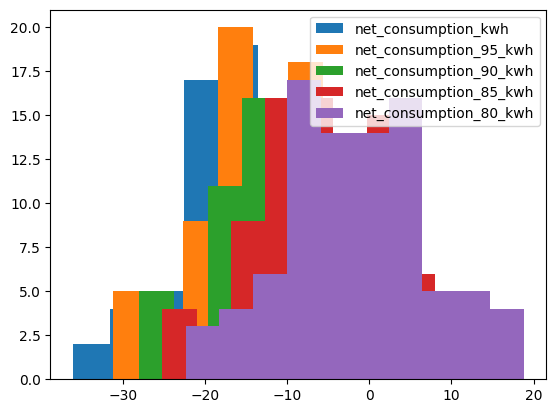

In [10]:
# So what we should see here is just proof of concept that our net consumption should
# move to the right as we reduce our energy consumption in these theoretical scenarios
for column in [
    "net_consumption_kwh",
    "net_consumption_95_kwh",
    "net_consumption_90_kwh",
    "net_consumption_85_kwh",
    "net_consumption_80_kwh",
]:
    plt.hist(df[column], label=column)

plt.legend()

In [108]:
# OKAY so, generally, we'll need a net consumption profile for each month that we want
# to consider
avgs = df.resample("M").mean()
stdvs = df.resample("M").std()

# July's data is in position 0; Augut's in position 1; September's in position 2
july_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_kwh"].iloc[0],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_kwh"].iloc[0],
)
august_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_kwh"].iloc[1],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_kwh"].iloc[1],
)
september_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_kwh"].iloc[2],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_kwh"].iloc[2],
)

/var/folders/tf/8zcmjl611pq3yzqnbd6q05fw0000gn/T/ipykernel_12771/1492495166.py:3: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  avgs = df.resample("M").mean()
/var/folders/tf/8zcmjl611pq3yzqnbd6q05fw0000gn/T/ipykernel_12771/1492495166.py:4: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  stdvs = df.resample("M").std()


In [109]:
# So overall we're looking at around 40KWH of batteries, warranteed to hold
# about 70% of its original capacity after 10 years.
battery_one = Battery(
    capacity_KWh=13.5,
    reserve_pct=0.05,
    degredation_profile=[0.05, 0.03, 0.03, 0.03, 0.03, 0.03, 0.03, 0.03, 0.02, 0.02],
)
battery_two = Battery(
    capacity_KWh=13.5,
    reserve_pct=0.05,
    degredation_profile=[0.05, 0.03, 0.03, 0.03, 0.03, 0.03, 0.03, 0.03, 0.02, 0.02],
)
battery_three = Battery(
    capacity_KWh=13.5,
    reserve_pct=0.05,
    degredation_profile=[0.05, 0.03, 0.03, 0.03, 0.03, 0.03, 0.03, 0.03, 0.02, 0.02],
)

# Then we'd want to simulate for each month
july_sim = SolarBatterySim(
    label="July",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=july_profile,
)
august_sim = SolarBatterySim(
    label="August",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=august_profile,
)
september_sim = SolarBatterySim(
    label="September",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=september_profile,
)

In [110]:
# So now we can get our results:
july_results = july_sim.multi_year_sim(10)
august_results = august_sim.multi_year_sim(10)
september_results = september_sim.multi_year_sim(10)

Text(0.0, 0.95, 'Assumes no changes in net consumption profile;\nAssumes battery degrades to 72% over ten years;\nAssumes 5% battery capacity always reserved;\nAssumes no energy conservation attempted;\nBased on data from 2024')

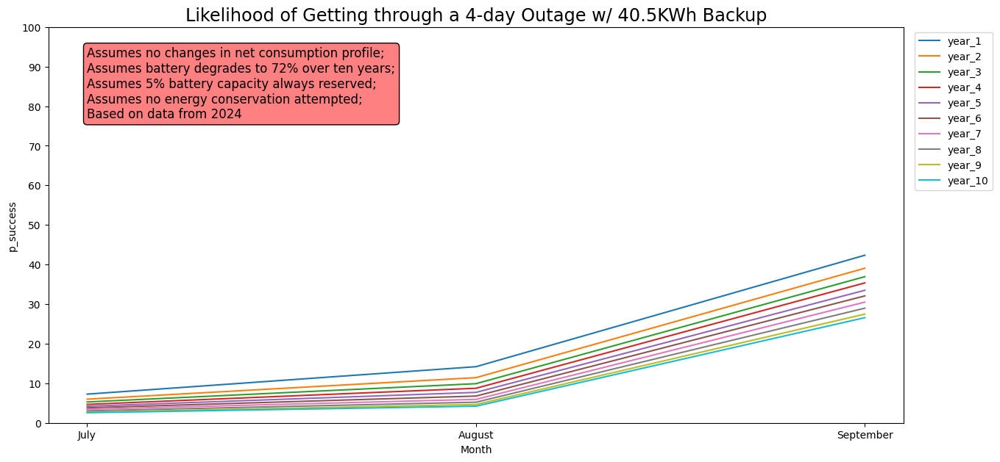

In [111]:
# And now we graph
plt.figure(figsize=(15, 7))
plt.title(
    "Likelihood of Getting through a 4-day Outage w/ 40.5KWh Backup", size="xx-large"
)

count = 1
for jul, aug, sep in zip(
    july_results.values(), august_results.values(), september_results.values()
):
    x = ["July", "August", "September"]
    y = [jul.p_success, aug.p_success, sep.p_success]
    plt.plot(x, y, label=f"year_{count}")
    count += 1

plt.ylim(0, 1)
plt.yticks(ticks=np.arange(0, 1.1, 0.1), labels=list(range(0, 110, 10)))

plt.ylabel("p_success")
plt.xlabel("Month")

plt.legend(bbox_to_anchor=(1.11, 1))

text = (
    "Assumes no changes in net consumption profile;"
    "\nAssumes battery degrades to 72% over ten years;"
    "\nAssumes 5% battery capacity always reserved;"
    "\nAssumes no energy conservation attempted;"
    "\nBased on data from 2024"
)
plt.text(
    0.00,
    0.95,
    text,
    verticalalignment="top",
    fontsize=12,
    bbox={"boxstyle": "round", "facecolor": "white", "fc": (1, 0.5, 0.5)},
)

In [112]:
# Let's do this again, but assume a 20% reduction in energy consumption
# July's data is in position 0; Augut's in position 1; September's in position 2
july_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_80_kwh"].iloc[0],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_80_kwh"].iloc[0],
)
august_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_80_kwh"].iloc[1],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_80_kwh"].iloc[1],
)
september_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_80_kwh"].iloc[2],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_80_kwh"].iloc[2],
)

# Simulate for each month
july_sim = SolarBatterySim(
    label="July_20_reduction",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=july_profile,
)
august_sim = SolarBatterySim(
    label="August_20_reduction",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=august_profile,
)
september_sim = SolarBatterySim(
    label="September_20_reduction",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=september_profile,
)

# Results
july_results = july_sim.multi_year_sim(10)
august_results = august_sim.multi_year_sim(10)
september_results = september_sim.multi_year_sim(10)

Text(0.0, 0.25, 'Assumes no changes in net consumption profile;\nAssumes battery degrades to 72% over ten years;\nAssumes 5% battery capacity always reserved;\nAssumes total consumption reduced by 20%;\nBased on data from 2024')

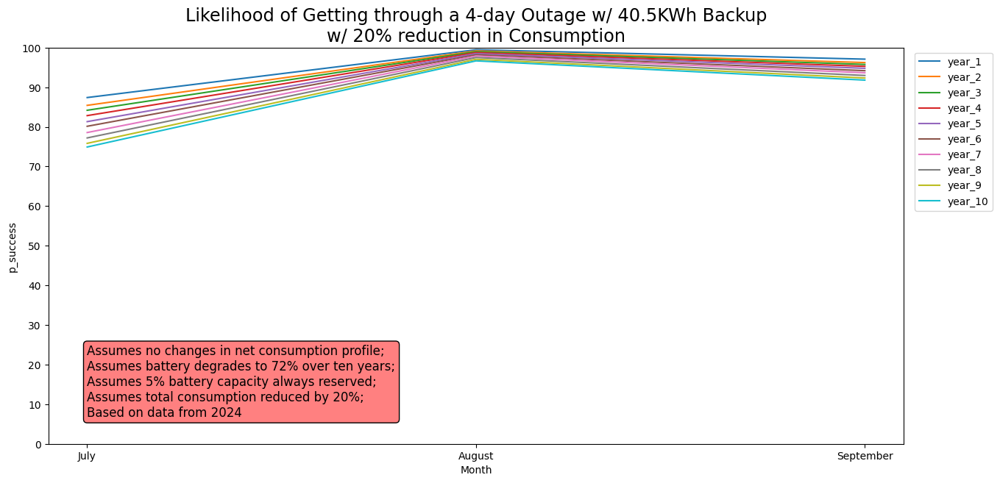

In [113]:
# And now we graph
plt.figure(figsize=(15, 7))
plt.title(
    "Likelihood of Getting through a 4-day Outage w/ 40.5KWh Backup\nw/ 20% reduction in Consumption",
    size="xx-large",
)

count = 1
for jul, aug, sep in zip(
    july_results.values(), august_results.values(), september_results.values()
):
    x = ["July", "August", "September"]
    y = [jul.p_success, aug.p_success, sep.p_success]
    plt.plot(x, y, label=f"year_{count}")
    count += 1

plt.ylim(0, 1)
plt.yticks(ticks=np.arange(0, 1.1, 0.1), labels=list(range(0, 110, 10)))

plt.ylabel("p_success")
plt.xlabel("Month")

plt.legend(bbox_to_anchor=(1.11, 1))

text = (
    "Assumes no changes in net consumption profile;"
    "\nAssumes battery degrades to 72% over ten years;"
    "\nAssumes 5% battery capacity always reserved;"
    "\nAssumes total consumption reduced by 20%;"
    "\nBased on data from 2024"
)
plt.text(
    0.00,
    0.25,
    text,
    verticalalignment="top",
    fontsize=12,
    bbox={"boxstyle": "round", "facecolor": "white", "fc": (1, 0.5, 0.5)},
)

In [114]:
# Let's do this again, but assume a 10% reduction in energy consumption
# July's data is in position 0; Augut's in position 1; September's in position 2
july_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_90_kwh"].iloc[0],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_90_kwh"].iloc[0],
)
august_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_90_kwh"].iloc[1],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_90_kwh"].iloc[1],
)
september_profile = NetConsumptionProfile(
    avg_net_consumption_KWh=avgs["net_consumption_90_kwh"].iloc[2],
    stdv_net_consumpetion_KWh=stdvs["net_consumption_90_kwh"].iloc[2],
)

# Simulate for each month
july_sim = SolarBatterySim(
    label="July_10_reduction",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=july_profile,
)
august_sim = SolarBatterySim(
    label="August_10_reduction",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=august_profile,
)
september_sim = SolarBatterySim(
    label="September_10_reduction",
    n_simulations=200_000,
    n_consecutive_days=4,
    batteries=[battery_one, battery_two, battery_three],
    profile=september_profile,
)

# Results
july_results = july_sim.multi_year_sim(10)
august_results = august_sim.multi_year_sim(10)
september_results = september_sim.multi_year_sim(10)

Text(0.0, 0.95, 'Assumes no changes in net consumption profile;\nAssumes battery degrades to 72% over ten years;\nAssumes 5% battery capacity always reserved;\nAssumes total consumption reduced by 10%;\nBased on data from 2024')

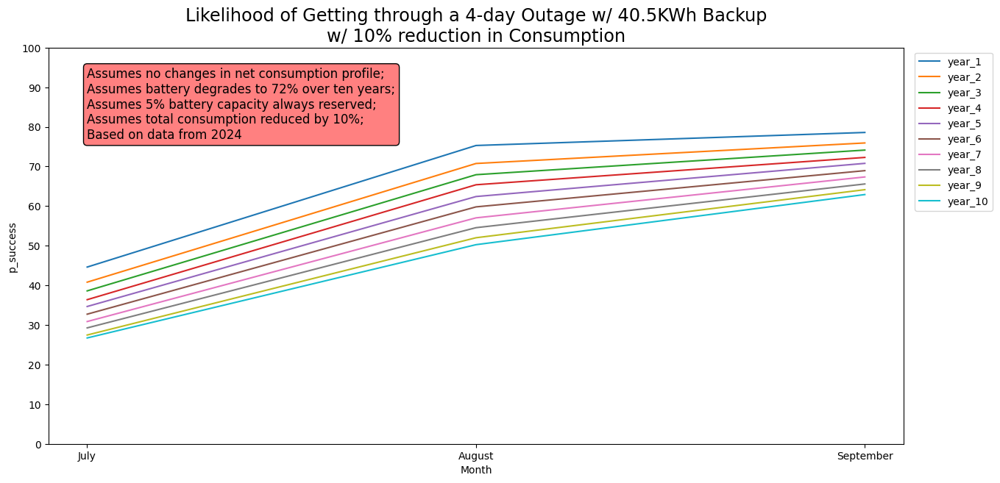

In [115]:
# And now we graph
plt.figure(figsize=(15, 7))
plt.title(
    "Likelihood of Getting through a 4-day Outage w/ 40.5KWh Backup\nw/ 10% reduction in Consumption",
    size="xx-large",
)

count = 1
for jul, aug, sep in zip(
    july_results.values(), august_results.values(), september_results.values()
):
    x = ["July", "August", "September"]
    y = [jul.p_success, aug.p_success, sep.p_success]
    plt.plot(x, y, label=f"year_{count}")
    count += 1

plt.ylim(0, 1)
plt.yticks(ticks=np.arange(0, 1.1, 0.1), labels=list(range(0, 110, 10)))

plt.ylabel("p_success")
plt.xlabel("Month")

plt.legend(bbox_to_anchor=(1.11, 1))

text = (
    "Assumes no changes in net consumption profile;"
    "\nAssumes battery degrades to 72% over ten years;"
    "\nAssumes 5% battery capacity always reserved;"
    "\nAssumes total consumption reduced by 10%;"
    "\nBased on data from 2024"
)
plt.text(
    0.00,
    0.95,
    text,
    verticalalignment="top",
    fontsize=12,
    bbox={"boxstyle": "round", "facecolor": "white", "fc": (1, 0.5, 0.5)},
)

In [116]:
13.5 * 3

40.5